# Interpretability of neuronal units in CLAP

Microsoft's [CLAP](https://github.com/microsoft/CLAP) (Contrastive Language-Audio Pretraining) is a model employing
a CNN-based audio encoder (which takes audio in the form of a logmel spectogram), a Transformer text encoder, and a
projection module which places the representations of these two modalities into a joint embedding space.

When restarting the kernel for running analyses, you can just run:

1. Imports and hyperparameters
2. Loading the model weights
3. Loading the dataset
4. Load the activations
5. Load the entropy and probability values

## Imports and hyperparameters

When restarting the kernel for running analyses, you can just run the imports and hyperparameters and then skip to [loading activations](#loading-activations).

In [42]:
from CLAPWrapper import CLAPWrapper
from esc50_dataset import ESC50
from transformers import BertTokenizer, BertModel
from surgeon_pytorch import Inspect, get_layers
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import cm
import plotly.express as px
import plotly.figure_factory as ff
from tqdm.notebook import tqdm, trange
from sklearn.metrics import accuracy_score
from sklearn.manifold import TSNE
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram
from IPython.display import Audio, Image, HTML, clear_output
from ipywidgets import widgets
from icecream import ic
from functools import reduce
import pandas as pd
import sys
import os

In [2]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
TOP_K = 100
NUM_CLASSES = 50

module_list = [
    'audio_encoder.base.fc1',
    'audio_encoder.projection.linear1',
    'audio_encoder.projection.linear2',
    'classification_layer'
]

## Loading the model and dataset
### Loading weights
Microsoft has made the pre-trained weights for CLAP available for download on request [here](https://zenodo.org/record/7312125#.Y22vecvMIQ9).

In [3]:
weights_path = "/scratch/pratyaksh.g/clap/CLAP_weights_2022_microsoft.pth"
clap_model = CLAPWrapper(weights_path, use_cuda=True if DEVICE == "cuda" else False)
clap_model.eval()

AttributeError: 'CLAPWrapper' object has no attribute 'eval'

### Loading dataset
We use the [ESC-50 dataset](https://github.com/karolpiczak/ESC-50), which consists of 2000 recordings across 50 classes of environmental sounds, each 5 seconds long.

In [5]:
dataset = ESC50(root="/scratch/pratyaksh.g/esc50/", download=False)

Using downloaded and verified file: /scratch/pratyaksh.g/esc50/ESC-50-master.zip


2000it [00:00, 11778.79it/s]

Loading audio files


You can now skip to [loading activations](#loading-activations) unless you've changed the activation collection mechanism.

### Storing activations
The audio encoder has the CNN section, followed by a fully connected layer that brings it to a dimensionality of 2048, and then to 527 for the Audioset classification task,
which was used to pre-train it. Then the projection layer has two fully connected layers, both of which have an output of dimensionality 1024.
The output of the final layer is the embedding of the audio in the joing space.

TODO: Add graph showing how outputs and inputs of the three layers are linked

We collect the activations on these three fully connected linear layers:
1. In the audio encoder, with output dimension 2048, which is followed by a ReLU
2. In the projection module, with output dimension 1024 which is followed by a GeLU
3. In the projection module again, with output dimension of 1024 with no activation

We use PyTorch's internal mechanism to hook onto these three modules using their names (which are in `module_list`). We then register a function to the hook which
simply stores the output from these modules. Note that the output is stored only from the linear layer, and therefore has not yet passed through the activation function.

In [6]:
module2name = dict((module, name) for name, module in clap_model.clap.named_modules())
raw_outputs = {}
activated_outputs = {}

def save_activation(module, input, output):
    if type(module) != str:
        name = module2name[module]
    else:
        name = module

    activation_fn = {
        'audio_encoder.base.fc1': F.relu,
        'audio_encoder.projection.linear1': F.gelu,
        'audio_encoder.projection.linear2': nn.Identity(),
        'classification_layer': nn.Identity()
    }

    activated_outputs[name] = activated_outputs.get(name, [])
    activation = activation_fn[name](output).squeeze().cpu().numpy()
    activated_outputs[name].append(activation)

    raw_outputs[name] = raw_outputs.get(name, [])
    raw_output = output.squeeze().cpu().numpy()
    raw_outputs[name].append(raw_output)

for name, module in clap_model.clap.named_modules():
    if name in module_list:
        module.register_forward_hook(save_activation)


### Classification on ESC-50
Due to the nature of CLAP, zero-shot classification can be done on the dataset. This is done by converting the class names to text prompts, and computing the text embeddings
for these prompts. Since these text embeddings exist in the same joint space as the audio embeddings, the logits for each class against an audio then just become the similarity
of the text embedding corresponding to that class to the audio embedding under consideration.

We also explicitly store these as the outputs/activations of the 'classification_layer', layer index 3. The 'classification_layer' outputs have the class indices according to the internal
dataset classes input though, instead of ESC50's, so we need to keep that in mind.

In [ ]:
# Computing text embeddings
prompt = 'this is a sound of '
y = [prompt + x for x in dataset.classes]
text_embeddings = clap_model.get_text_embeddings(y)

In [ ]:
# Computing audio embeddings
y_preds, y_labels = [], []
for layer_idx in tqdm(range(len(dataset))):
    x, _, one_hot_target = dataset.__getitem__(layer_idx)
    audio_embeddings = clap_model.get_audio_embeddings([x], resample=True)
    similarity = clap_model.compute_similarity(audio_embeddings, text_embeddings)
    y_pred = F.softmax(similarity.detach().cpu(), dim=1).numpy()
    save_activation('classification_layer', similarity, F.softmax(similarity.detach(), dim=1))
    y_preds.append(y_pred)
    y_labels.append(one_hot_target.detach().cpu().numpy())

clear_output()
print("Done!")
print("Computed audio embeddings for {} samples".format(len(dataset)))

In [ ]:
y_labels, y_preds = np.concatenate(y_labels, axis=0), np.concatenate(y_preds, axis=0)
acc = accuracy_score(np.argmax(y_labels, axis=1), np.argmax(y_preds, axis=1))
print('ESC50 Accuracy {}'.format(acc))

## Storing activation values
The activation values that are recorded from running the ESC-50 dataset through the CLAP model now need to be prepared for further analysis.
Storing them in a pandas dataframe is a convenient method since it allows us to arbitrarily group them easily. We also write the dataframe
to csv, so the analysis can actually be performed without the need to actually run the entire model everytime.

In [ ]:
# Format the dataframe properly
records = []
for layer_idx, layer_name in enumerate(tqdm(module_list)):
    for patch_idx, patch in enumerate(tqdm(dataset)):
        patch = dataset[patch_idx]
        patch_name = patch[0].split('/')[-1].split('.')[0]
        class_name = patch[1]
        class_idx = patch_name.split('-')[-1]

        ndim = activated_outputs[layer_name][patch_idx].shape[-1]

        current_record = pd.DataFrame({
            'layer_idx': [layer_idx] * ndim,
            'layer_name': [layer_name] * ndim,
            'neuron_idx': list(range(ndim)),
            'patch_idx': [patch_idx] * ndim,
            'patch_name': [patch_name] * ndim,
            'raw_output': raw_outputs[layer_name][patch_idx],
            'activation': activated_outputs[layer_name][patch_idx],
            'class_idx': [class_idx] * ndim,
            'class_name': [class_name] * ndim,
        })

        records.append(current_record)

act_values = pd.concat(records, ignore_index=True)
act_values.to_csv('/home2/pratyaksh.g/MS-CLAP/src/activations.csv')

clear_output()
print("Done!")
print("Stored for {} layers and {} patches".format(len(module_list), len(dataset)))

## Loading activations
Since we stored the activations, we need not compute them everytime. We can just load them from here and continue on with the analysis.

In [6]:
activations = pd.read_csv('/home2/pratyaksh.g/MS-CLAP/src/activations.csv', index_col=0)

### Computing zero neurons
Neurons in each layer which have zero output after activation for **all** datapoints in the dataset are what we call as 'zero' or 'null' neurons. With respect to this
specific dataset, they do not contribute to the information for the final classification (or do they?).

We compute the number of zero neurons in each layer.

In [10]:
all_neurons = []
zero_neurons = []
for layer_idx, layer_name in enumerate(tqdm(module_list)):
    # Compute the number of records in the dataframe for this layer that have a unique neuronal index
    num_neurons = len(act_values[act_values['layer_name'] == layer_name]['neuron_idx'].unique())
    all_neurons.append(num_neurons)

    # Now for each neuron index, sum the activations across all patches and check if the sum is zero,
    num_zero_neurons = len(act_values[act_values['layer_name'] == layer_name].groupby('neuron_idx').sum().query('activation == 0'))
    zero_neurons.append(num_zero_neurons)
    
clear_output()
print("Done!")
for all, zero, layer_idx in zip(all_neurons, zero_neurons, range(len((module_list)))):
    print("Layer {} has {} neurons, of which {} are zero".format(layer_idx, all, zero))

Done!
Layer 0 has 2048 neurons, of which 525 are zero
Layer 1 has 1024 neurons, of which 0 are zero
Layer 2 has 1024 neurons, of which 0 are zero
Layer 3 has 50 neurons, of which 0 are zero


## Computing entropy values
We then take just the top K most activating datapoints for that neuron and generate a probability distribution for each neuron:
the probability that one of the top K most activating dataset examples is from a certain class in the dataset.

In most cases, you can again skip this and [load the values directly](#loading-entropy-values).

In [29]:
entropies = pd.DataFrame(columns=['layer_idx', 'neuron_idx', 'entropy', 'probabilities', 'cumulative_dist'])

for layer_idx, layer_name in enumerate(tqdm(module_list)):
    num_neurons = len(activations[activations['layer_idx'] == layer_idx]['neuron_idx'].unique())

    for neuron_idx in tqdm(range(num_neurons)):
        # For each neuron, get the TOP_K non-zero patches
        neuron_activations = activations[(activations['layer_idx'] == layer_idx) & (activations['neuron_idx'] == neuron_idx)]
        neuron_activations = neuron_activations[neuron_activations['activation'] > 0]
        neuron_activations = neuron_activations.sort_values(by='activation', ascending=False)
        neuron_activations = neuron_activations.head(TOP_K)

        if len(neuron_activations) == 0:
            # This neuron is dead, we assign it a zero entropy
            neuron_entropy = 0.0
            class_probs = {class_idx: 0.0 for class_idx in range(NUM_CLASSES)}
            cumulative_logits = {class_idx: 0.0 for class_idx in range(NUM_CLASSES)}
            entropies.loc[len(entropies)] = [layer_idx, neuron_idx, neuron_entropy, list(class_probs.values()), list(cumulative_logits.values())]
            continue

        # Now compute the count vector for each class, and then the class probabilities
        class_counts = neuron_activations.groupby('class_idx').count()['activation'].to_dict()
        class_probs = {class_idx: class_counts.get(class_idx, 0) / len(neuron_activations) for class_idx in range(NUM_CLASSES)}

        # We also take the cumulative sum of the logits, and then normalize them
        # We refer to this as the "cumulative distribution" or 'cumulative_dist'
        cumulative_logits = neuron_activations.groupby('class_idx').sum()['activation'].to_dict()
        cumulative_dist = {class_idx: cumulative_logits.get(class_idx, 0) / sum(cumulative_logits.values()) for class_idx in range(NUM_CLASSES)}

        # sanity check: assert that the sum of the probabilities is 1
        assert np.isclose(sum(class_probs.values()), 1.0)

        # We need to compute the entropy of this distribution
        # NOTE: We use log base 2, so the entropy is in bits
        def shannon_entropy(dist):
            entropy = 0
            for p in dist:
                if p > 0:
                    entropy -= p * np.log2(p)
            return entropy

        # We compute it for the neuron and add it to the entropies dataframe
        neuron_entropy = shannon_entropy(list(class_probs.values()))

        # Another sanity check: assert that entropy is 0 only if the distribution is deterministic
        assert np.isclose(neuron_entropy, 0.0) == (1.0 in class_probs.values())

        entropies.loc[len(entropies)] = [layer_idx, neuron_idx, neuron_entropy, list(class_probs.values()), list(cumulative_dist.values())]

entropies.to_csv('/home2/pratyaksh.g/MS-CLAP/src/entropies.csv')
clear_output()
print("Done!")
print("Computed entropies for {} layers".format(len(module_list)))

Done!
Computed entropies for 4 layers


### Loading entropy values

In [22]:
entropies = pd.read_csv('/home2/pratyaksh.g/MS-CLAP/src/entropies.csv', index_col=0)
# Convert the probabilities column to a dictionary of class_idx: probability
entropies['probabilities'] = entropies['probabilities'].apply(lambda x: eval(x))
# and make sure each element in the probabilty list is a float
entropies['probabilities'] = entropies['probabilities'].apply(lambda x: [float(y) for y in x])
# Do the same for the cumulative_dist column
entropies['cumulative_dist'] = entropies['cumulative_dist'].apply(lambda x: eval(x))
entropies['cumulative_dist'] = entropies['cumulative_dist'].apply(lambda x: [float(y) for y in x])

## Plotting entropies

In [26]:
def plot_entropies(modules_to_plot=range(len(module_list))):
    # Now we plot the entropies for each layer as a histogram with a KDE plot
    sns.set_style('whitegrid')
    sns.set_context('notebook')
    sns.set_palette('muted')
    fig, ax = plt.subplots(figsize=(8, 6))

    data = entropies[(entropies['layer_idx'].isin(modules_to_plot)) & (entropies['entropy'] > 0)]
    # Set the density to True so that the histogram is normalized
    sns.histplot(data=data, x='entropy', hue='layer_idx', kde=True, ax=ax, stat='density', common_norm=False, bins=30)

    # Also plot the median entropy for each layer
    for layer_idx in modules_to_plot:
        median_entropy = data[data['layer_idx'] == layer_idx]['entropy'].median()
        print(f'Layer {layer_idx} Median Entropy: {median_entropy:.4f}')

        ax.axvline(median_entropy, color=f'C{layer_idx}', linestyle='-.', label=f'Layer {layer_idx} Median')
        plt.annotate(f'{layer_idx}', xy=(median_entropy, plt.ylim()[1]), xytext=(0, 0),
                textcoords='offset points', ha='center', va='bottom', color='black')

    plt.savefig('/home2/pratyaksh.g/MS-CLAP/src/entropy.png', dpi=300)
    plt.show()
    plt.close()

Layer 0 Median Entropy: 2.8882
Layer 1 Median Entropy: 2.8253
Layer 2 Median Entropy: 3.1271
Layer 3 Median Entropy: 2.6879


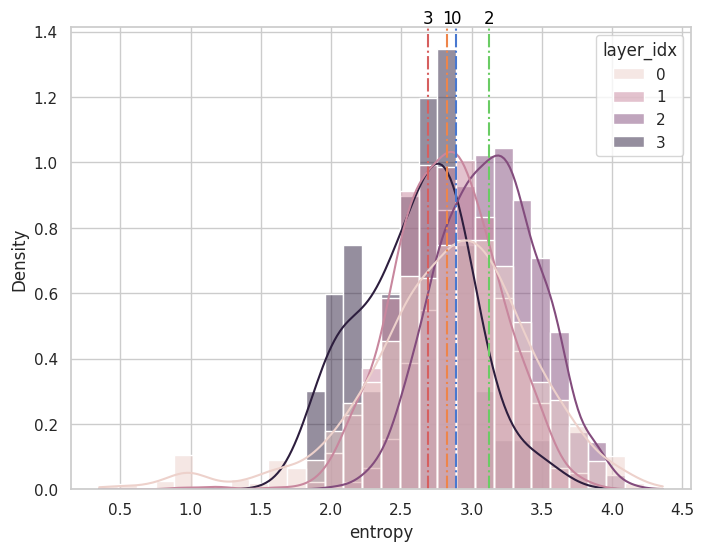

In [30]:
plot_entropies()

## Dual neurons in layer 0
If you look closely at the layer 0 entropy distribution, we can see there's a small bump near 1.0, which we don't see in the other layers. An entropy of 1.0 corresponds to a 0.5 probability of being one of two classes. We inspect which neurons actually have an entropy close to 1.0 (turns out, for a tolerance of 0.01, they're *all* in layer 0).

Layer 0 Median Entropy: 2.8882


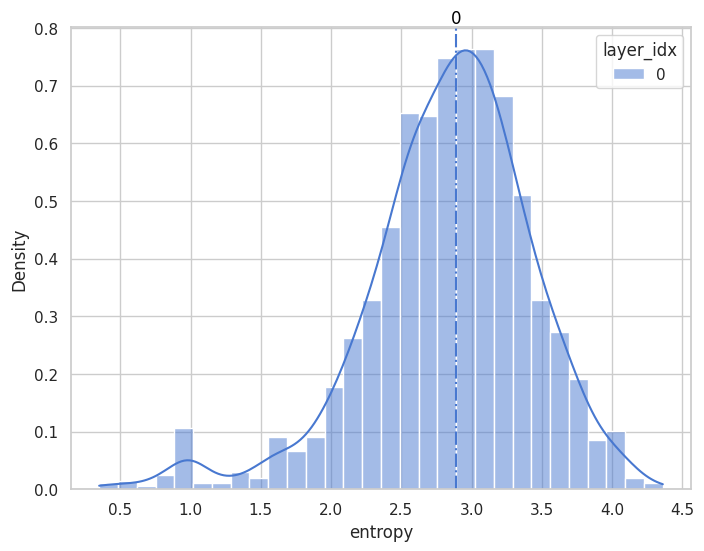

In [28]:
plot_entropies([0])

In [44]:
dual_neurons = entropies[np.isclose(entropies['entropy'], 1.0, atol=1e-2)]
dual_neurons

,layer_idx,neuron_idx,entropy,probabilities
245,0,245,1.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
260,0,260,1.0,"[0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
604,0,604,1.0,"[0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
659,0,659,1.0,"[0.0, 0.0, 0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
965,0,965,1.0,"[0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
982,0,982,1.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1121,0,1121,1.0,"[0.5, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1242,0,1242,1.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1309,0,1309,1.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1499,0,1499,1.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


We can take a closer look at these neurons and what classes they're perfectly split over.

In [45]:
# Find the indices where the probabilities are 0.5
dual_neurons['probabilities'].apply(lambda x: tuple(map(lambda y: dataset.classes[y], np.where(np.isclose(x, 0.5, 1e-4))[0])))

245     (footsteps, mouse click)
260           (dog, mouse click)
604           (dog, mouse click)
659           (pig, mouse click)
965           (dog, can opening)
982     (footsteps, mouse click)
1121             (dog, coughing)
1242    (footsteps, mouse click)
1309      (clock tick, chainsaw)
1499    (footsteps, mouse click)
1576             (dog, coughing)
1620          (dog, mouse click)
1739      (breathing, footsteps)
1794    (footsteps, mouse click)
1836    (footsteps, mouse click)
1889    (footsteps, mouse click)
Name: probabilities, dtype: object

## Neuron clustering

It would be infeasible to check every single neuron in each of the layers and form some hypotheses about what they're responsible for, thus we first attempt to cluster
neurons together to try and see if we can find groups of neurons acting together towards predicting some class a lot. This information would hopefully give us context
about either redundant or complementary sets of neurons.

In [10]:
def dendrogram_ordering(layer_idx, distribution='cumulative_dist'):
    cur_entropies = entropies[entropies['layer_idx'] == layer_idx]

    method = 'ward'
    metric = 'euclidean'

    probs = np.array(cur_entropies[distribution].to_list())

    R = dendrogram(
            linkage(probs, method=method, metric=metric),
            no_plot=True,
    )
    ordered_neurons = R['leaves']
    return ordered_neurons

In [10]:
clusters = pd.DataFrame(columns=['layer_idx', 'neuron_idx', 'cluster'])

def cluster_neurons(layer_idx=None, n_clusters=50, algorithm='agglomerative'):
    # NOTE: Clustering results for 'agglomerative' are 1 indexed!
    # Cluster the neurons using k-means
    if layer_idx is not None:
        cur_entropies = entropies[entropies['layer_idx'] == layer_idx]
        clusters.drop(clusters[clusters['layer_idx'] == layer_idx].index, inplace=True)
    else:
        cur_entropies = entropies
        clusters.drop(clusters.index, inplace=True)

    probs = np.array(cur_entropies['probabilities'].to_list())

    if algorithm == 'agglomerative':
        linkage_matrix = linkage(probs, method='ward', metric='euclidean')
        # Threshold is such that we get the desired number of clusters
        clustering = fcluster(linkage_matrix, t=n_clusters, criterion='maxclust')
    else:
        raise ValueError(f'Unknown clustering algorithm {algorithm}')

    for neuron_idx in range(len(clustering)):
        clusters.loc[len(clusters)] = [layer_idx, neuron_idx, clustering[neuron_idx]]

    return clustering

We will use agglomerative clustering with a Euclidean distance metric and ward linkage to actually cluster neurons in a given layer together.
The resultant dendrogram would have a lot of leaves and therefore is a pretty dense graph. In order to be able to better parse the leaves of the dendrogram,
we need a summary of the probability distribution for each leaf. For this, we mark the top few classes in the neuron's TOP_K, and the corresponding probabilities.
We also abbreviate the class names into three letters for ease of visual understanding.

In [11]:
# 3 letter abbreviations for each class
label_to_abbreviation = {
    'dog': 'dog',
    'rooster': 'ros',
    'pig': 'pig',
    'cow': 'cow',
    'frog': 'frg',
    'cat': 'cat',
    'hen': 'hen',
    'insects': 'ins',
    'sheep': 'shp',
    'crow': 'cro',
    'rain': 'rai',
    'sea waves': 'sea',
    'crackling fire': 'crk',
    'crickets': 'cri',
    'chirping birds': 'chi',
    'water drops': 'dro',
    'wind': 'wnd',
    'pouring water': 'pou',
    'toilet flush': 'toi',
    'thunderstorm': 'thu',
    'crying baby': 'cba',
    'sneezing': 'sne',
    'clapping': 'clp',
    'breathing': 'bre',
    'coughing': 'cou',
    'footsteps': 'fot',
    'laughing': 'laf',
    'brushing teeth': 'bte',
    'snoring': 'snr',
    'drinking sipping': 'dsi',
    'door wood knock': 'dkn',
    'mouse click': 'mcl',
    'keyboard typing': 'kty',
    'door wood creaks': 'dcr',
    'can opening': 'can',
    'washing machine': 'wma',
    'vacuum cleaner': 'vac',
    'clock alarm': 'cal',
    'clock tick': 'ctk',
    'glass breaking': 'glb',
    'helicopter': 'hel',
    'chainsaw': 'cha',
    'siren': 'sir',
    'car horn': 'hon',
    'engine': 'eng',
    'train': 'tra',
    'church bells': 'bel',
    'airplane': 'air',
    'fireworks': 'fir',
    'hand saw': 'saw'
}

We take the top 3 classes in terms of probability for that specific neuron and use that to construct an informative label.
This label, in addition with a color strip visualization allows us to get a quick summary of the neurons so as to assess their
clustering better.

The `distribution` variable controls whether to use the normal probability distribution or the distribution formed out of the cumulative logits.

In [30]:
# distribution = 'probabilities'
distribution = 'cumulative_dist'

argmax_labels = {}
for layer_idx in range(len(module_list)):
    argmax_labels[layer_idx] = []
    for neuron_idx, prob in enumerate(entropies[entropies['layer_idx'] == layer_idx][distribution].to_list()):
        # max_class_label = label_to_abbreviation[dataset.classes[np.argmax(prob)]]
        # max_class_prob = np.max(prob)
        # argmax_labels[layer_idx].append(f'{neuron_idx} {max_class_label}: {max_class_prob:.0%}')

        # Get the top 3 classes and their probabilities
        top_3_classes = np.argsort(prob)[-3:][::-1]
        top_3_probs = np.array(prob)[top_3_classes]
        # Make a list of strings: the abbreviation and the probability in percent
        top_3_labels = [f'{label_to_abbreviation[dataset.classes[class_idx]]}: {prob:.0%}' for class_idx, prob in zip(top_3_classes, top_3_probs)]
        # Join the list of strings with a comma
        top_3_labels = ', '.join(top_3_labels)
        argmax_labels[layer_idx].append(f'{neuron_idx} - {top_3_labels}')

In [31]:
def plot_dendogram(layer_idx, slice=None, interactive=False, figsize=None, p=None, truncate_mode=None, color_threshold=None, remove_zeros=True):
        cur_entropies = entropies[entropies['layer_idx'] == layer_idx]

        if remove_zeros:
                zero_neurons = activations[activations['layer_idx'] == layer_idx].groupby('neuron_idx').sum().query('activation == 0').reset_index()['neuron_idx'].to_list()
                cur_entropies = cur_entropies[~cur_entropies['neuron_idx'].isin(zero_neurons)]
                argmax_labels[layer_idx] = [x for x in argmax_labels[layer_idx] if int(x.split()[0]) not in zero_neurons]

        # we also need to preserve a map from the new neuron indices to the old ones
        new_to_old_idx_map = {new_idx: old_idx for new_idx, old_idx in enumerate(cur_entropies['neuron_idx'].to_list())}
        probs = np.array(cur_entropies[distribution].to_list())
        labels = argmax_labels[layer_idx]

        if slice is not None:
                left, right = slice
                probs = probs[left:right]
                labels = labels[left:right]

        # Use plotly to generate the diagram if interactive is True
        if interactive:
                fig = ff.create_dendrogram(
                        probs, labels=labels, orientation='left',
                        linkagefun=lambda x: linkage(probs, method='ward', metric='euclidean')
                )
                fig.update_layout(width=1720, height=900)
                fig.show()

        # Otherwise use matplotlib
        else:
                fig = plt.figure()

                method = 'ward'
                metric = 'euclidean'
                truncate_mode = 'lastp' if truncate_mode is None else truncate_mode
                p = 10 if p is None else p
                color_threshold = 0.1 if color_threshold is None else color_threshold
                ax = plt.subplot(1, 30, (1, 29))

                R = dendrogram(
                        linkage(probs, method=method, metric=metric),
                        truncate_mode=truncate_mode,
                        p=p,
                        color_threshold=color_threshold,
                        ax=ax,
                        labels=labels,
                        orientation='left'
                )

                fig.suptitle(f'Dendrogram plot for the clustering of layer {layer_idx} neurons',fontsize=20, x=0.515, y=0.94)
                ax.set_title(f'(method={method}, metric={metric}, truncate_mode={truncate_mode}, p={p}, color_threshold={color_threshold}){"" if not remove_zeros else " (zero neurons removed)"}', fontsize=15)
                ax.set_ylabel('Neuron Index')
                ax.set_xlabel('Distance')
                end, start = ax.get_xlim()
                end = 20.0 if end > 20.0 else end
                ax.set_xlim((end, start))
                ax.set_xticks(np.arange(start, end, 0.1))
                ax.axvline(color_threshold, color='r', linestyle='-', label=f'color_threshold={color_threshold}')

                # Then we plot the probability color bar
                ordered_neurons = R['leaves']
                mapped_ordered_neurons = [new_to_old_idx_map[x] for x in ordered_neurons]

                for neuron in ordered_neurons:
                        assert not np.isclose(probs[neuron].sum(), 0.0)

                # Assumes single layer under consideration
                cur_entropies = entropies[(entropies['layer_idx'] == layer_idx)].copy(deep=True)
                cur_entropies.set_index('neuron_idx', inplace=True)

                # Ensure that the mapped ordered neurons and zero neurons are disjoint and their union is the set of all neurons in the layer
                assert list(set(mapped_ordered_neurons) & set(zero_neurons)) == []
                assert list(set(mapped_ordered_neurons) | set(zero_neurons)) == list(range(len(cur_entropies)))

                cur_entropies = cur_entropies.loc[mapped_ordered_neurons]
                probs = cur_entropies[distribution]
                # reduce the probabilities that are below a threshold (0.1) to 0
                probs = probs.apply(lambda x: [0 if y < 0.1 else y for y in x])

                ax = plt.subplot(1, 30, 30)
                distribution_name = 'Probabilities' if distribution == 'probabilities' else 'Cumulative Distribution'
                ax.set_title(f'Class {distribution_name}', fontsize=15)

                # replace the ordered neuron indices with the labels, for each corresponding index record
                cols = [f'{x} ({label_to_abbreviation[x]})' for x in dataset.classes]
                # Note that the probs dataframe used mapped_ordered_neurons to get the appropriate neurons, but then we use the
                # *unmapped* ordered neurons to index into the labels list, since probs.to_list() will return an appropriate list.
                prob_df = pd.DataFrame(probs.to_list(), columns=cols, index=ordered_neurons)
                prob_df.index = [labels[x] for x in prob_df.index]
                prob_df.plot.barh(figsize=(6, 10), stacked=True, legend=False, color=sns.color_palette('muted', n_colors=50), width=0.75, ax=ax)

                axes = fig.get_axes()
                axes[0].get_shared_y_axes().join(axes[1], axes[0])
                axes[0].set_yticks([])
                axes[1].yaxis.tick_right()

                width, height = figsize if figsize is not None else (30, 10)
                fig.set_figwidth(width)
                fig.set_figheight(height)

                # # Add a legend, and make its size small, and move the bbox of the legend further down
                # legend = ax.legend(loc='lower center', ncol=5, framealpha=1.0, prop={'size': 4})
                # bbox = legend.get_window_extent()
                # expand = [-5, -5, 5, 5]
                # bbox = bbox.from_extents(*(bbox.extents + np.array(expand)))
                # bbox = bbox.transformed(fig.dpi_scale_trans.inverted())
                # fig.savefig('/home2/pratyaksh.g/MS-CLAP/fig/legend.pdf', bbox_inches=bbox)

                plt.savefig(f'/home2/pratyaksh.g/MS-CLAP/fig/{layer_idx}-dendrogram-{distribution}-ct={color_threshold}.pdf')
                plt.clf()
                plt.close()

                return R

#### Code for figures and unclustered neuron reports
The code bugs out for running all the loops simultaneously (especially for layer 0), so we manually unfold the loops some

In [32]:
figsizes = [(225, 200), (150, 140), (150, 140), (30, 10)]
color_thresholds = [0.3, 0.5, 0.7]
num_neurons = [2048, 1024, 1024, 50]

def plot_and_report_unclustered(layer_idx, ct):
        R = plot_dendogram(layer_idx, interactive=False, truncate_mode='none', figsize=figsizes[layer_idx], color_threshold=ct, remove_zeros=True)

        leaves_colors = R['leaves_color_list']
        unclustered = leaves_colors.count('C0') # This is the color of the unclustered neurons by default
        print(f'For layer {layer_idx}, color_threshold={ct}, {unclustered} neurons are unclustered ({unclustered / num_neurons[layer_idx] * 100:.2f}%)')

##### Layer 0

In [38]:
plot_and_report_unclustered(0, 0.3)

For layer 0, color_threshold=0.3, 352 neurons are unclustered (17.19%)


In [39]:
plot_and_report_unclustered(0, 0.5)

For layer 0, color_threshold=0.5, 15 neurons are unclustered (0.73%)


In [40]:
plot_and_report_unclustered(0, 0.7)

For layer 0, color_threshold=0.7, 7 neurons are unclustered (0.34%)


##### Layer 1

In [37]:
for ct in color_thresholds:
    plot_and_report_unclustered(1, ct)

For layer 1, color_threshold=0.3, 351 neurons are unclustered (34.28%)
For layer 1, color_threshold=0.5, 6 neurons are unclustered (0.59%)
For layer 1, color_threshold=0.7, 1 neurons are unclustered (0.10%)


##### Layer 2

In [36]:
color_thresholds = [0.3, 0.5, 0.7]
for ct in color_thresholds:
    plot_and_report_unclustered(2, ct)

For layer 2, color_threshold=0.3, 255 neurons are unclustered (24.90%)
For layer 2, color_threshold=0.5, 1 neurons are unclustered (0.10%)
For layer 2, color_threshold=0.7, 0 neurons are unclustered (0.00%)


##### Layer 3

In [35]:
color_thresholds = [0.3, 0.5, 0.7]
# color_thresholds = [0.9, 1.1, 1.3]
for ct in color_thresholds:
    plot_and_report_unclustered(3, ct)

For layer 3, color_threshold=0.3, 50 neurons are unclustered (100.00%)
For layer 3, color_threshold=0.5, 48 neurons are unclustered (96.00%)
For layer 3, color_threshold=0.7, 40 neurons are unclustered (80.00%)


### Add ordering info to entropies

The ordering prescribed by the dendrogram (*without* zero neuron removal), can just be stored within the entropies dataframe itself. Note that in the actual dendrogram plot, the neuron indexed with 0 in the dendrogram indexing, is actually at the bottom of the dendrogram

In [35]:
dendrogram_indices = []
for layer_idx in range(len(module_list)):
    ordered_neurons = dendrogram_ordering(layer_idx)
    # This tells us what neuron to put a given position of the dendrogram,
    # but we want to know what position of the dendrogram a given neuron is.
    # So we reverse the mapping
    dendro = {neuron_idx: dendro_pos for dendro_pos, neuron_idx in enumerate(ordered_neurons)}
    _, dendro = zip(*sorted(dendro.items()))
    dendrogram_indices += dendro

entropies['dendrogram_idx'] = dendrogram_indices

In [36]:
entropies.to_csv('/home2/pratyaksh.g/MS-CLAP/src/entropies.csv')

## Other visualizations for clusters

In [83]:
def plot_neurons_over_clusters(clustering):
    # plot the distribution of neurons across clusters with plotly as a bar plot
    cluster_indices, neuron_counts = np.unique(clustering, return_counts=True)
    fig = px.bar(x=cluster_indices, y=neuron_counts)
    fig.update_layout(
        title=f'Neuron Distribution Across {len(clustering)} Clusters',
        xaxis_title='Cluster',
        yaxis_title='Count',
        xaxis=dict(
            tickmode='linear',
            tick0=0,
            dtick=1
        )
    )
    fig.show()

In [165]:
plot_neurons_over_clusters(clustering)

In [170]:
def plot_entropy_boxplot():
    # Using plotly, plot the entropy distribution for each cluster as a boxplot
    df = pd.merge(entropies, clusters, on=['layer_idx', 'neuron_idx'])
    # fig = px.box(df, x='cluster', y='entropy')
    fig.update_layout(
        title=f'Entropy Distribution Across {len(clustering)} Clusters',
        xaxis_title='Cluster',
        yaxis_title='Entropy',
        xaxis=dict(
            tickmode='linear',
            tick0=0,
            dtick=1
        )
    )

    fig.show()

In [171]:
plot_entropy_boxplot()

In [ ]:
def plot_cluster(cluster, k=5, ascending=False):
    top_neurons = entropies[entropies['cluster'] == cluster].sort_values(by='entropy', ascending=ascending).head(k)
    layer_indices, neuron_indices = zip(*top_neurons[['layer_idx', 'neuron_idx']].itertuples(index=False))

    # Using seaborn, plot the class probabilities for each of these neurons in the same plot
    sns.set_style('whitegrid')
    sns.set_context('notebook')
    sns.set_palette('muted')
    fig, ax = plt.subplots(figsize=(20, 6))

    # Plot as a bar graph with class names on the x-axis and probabilities on the y-axis
    for layer_idx, neuron_idx in zip(layer_indices, neuron_indices):
        class_probs = entropies[(entropies['layer_idx'] == layer_idx) & (entropies['neuron_idx'] == neuron_idx)]['probabilities'].values[0]
        class_probs = {dataset.classes[int(class_idx)]: prob for class_idx, prob in class_probs.items()}
        ax.bar(class_probs.keys(), class_probs.values(), label=f'Layer {layer_idx} Neuron {neuron_idx}')
    
    # Rotate the x-axis labels by 90 degrees, and force more space between them
    plt.xticks(rotation=90)
    plt.subplots_adjust(bottom=0.3)
    ax.set_xlabel('Class')
    ax.set_ylabel('Probability')
    ax.set_title(f'Cluster {cluster} Class Probabilities')
    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
    plt.show()

In [ ]:
plot_neurons_over_clusters()

In [ ]:
plot_cluster(24, k=4, ascending=True)

## Individual neuron inspection

In [16]:
def plot_class_counts(layer_idx, neuron_idx, k=TOP_K, include_zero_activations=False):
    # Print the entropy of this neuron
    neuron_entropy = entropies[(entropies['layer_idx'] == layer_idx) & (entropies['neuron_idx'] == neuron_idx)]['entropy'].values[0]
    print(f'Layer {layer_idx} Neuron {neuron_idx} Entropy: {neuron_entropy:.4f}')

    neuron_activations = activations[(activations['layer_idx'] == layer_idx) & (activations['neuron_idx'] == neuron_idx)]
    if include_zero_activations == False:
        neuron_activations = neuron_activations[neuron_activations['activation'] > 0]
    neuron_activations = neuron_activations.sort_values(by='activation', ascending=False)
    neuron_activations = neuron_activations.head(k)

    if neuron_activations.max()['activation'] <= 0:
        print(f'WARNING: Layer {layer_idx} Neuron {neuron_idx} is dead')

    # Plot these counts as a bar plot
    class_counts = neuron_activations.groupby('class_name').count()['activation'].to_dict()
    class_counts = {class_name: count for class_name, count in class_counts.items()}
    class_counts = {class_name: class_counts.get(class_name, 0) for class_name in dataset.classes}

    print(f'Number of examples plotted: {len(neuron_activations)}')

    # plot as a bar graph with plotly
    fig = px.bar(x=list(class_counts.keys()), y=list(class_counts.values()))
    fig.update_layout(
        title=f'Layer {layer_idx} Neuron {neuron_idx} Class Counts',
        xaxis_title='Class',
        yaxis_title='Count',
        xaxis=dict(
            tickmode='linear',
            tick0=0,
            dtick=1
        )
    )
    fig.show()

In [7]:
def maximal_dataset_examples(layer_idx, neuron_idx, ascending=False, classes=dataset.classes, k=10):
    # Get the maximal activations for the neuron
    global activations
    neuron_activations = activations[(activations['layer_idx'] == layer_idx) & (activations['neuron_idx'] == neuron_idx)]
    neuron_activations = neuron_activations[neuron_activations['class_name'].isin(classes)]

    # Look at the top k activations
    neuron_activations = neuron_activations.sort_values(by='activation', ascending=ascending)
    neuron_activations = neuron_activations.head(k)

    if neuron_activations.max()['activation'] <= 0:
        print(f'WARNING: Layer {layer_idx} Neuron {neuron_idx} is dead')

    patch_idxs = neuron_activations['patch_idx']
    patch_names = neuron_activations['patch_name']
    audio_paths = [dataset[patch_idx][0] for patch_idx in patch_idxs]
    act_values = [activation for activation in neuron_activations['activation']]
    class_names = [class_name for class_name in neuron_activations['class_name']]

    # Show the top activations
    print('Top 10 maximal activations for Layer {} Neuron {}:\n'.format(layer_idx, neuron_idx))
    for i in range(len(audio_paths)):
        print('====================================================================================================')
        audio_tensor = clap_model.load_audio_into_tensor(audio_paths[i], 5).unsqueeze(0) # 5 is for 5 seconds
        spectrogram = clap_model.clap.audio_encoder.base.spectrogram_extractor(audio_tensor)
        logmel_spectrogram = clap_model.clap.audio_encoder.base.logmel_extractor(spectrogram)
        fig = px.imshow(logmel_spectrogram.squeeze(0).squeeze(0).T.cpu(), origin='lower', color_continuous_scale='jet')
        fig.show()
        display(Audio(audio_paths[i]))
        # TODO: Change to html elements and add horizontal rule
        print(f'Example {i + 1}:')
        print(f'Class: {class_names[i]}')
        print(f'Activation: {act_values[i]:.4f}')
        print(f'Audio Path: {audio_paths[i]}')
        print('====================================================================================================\n')

In [18]:
def get_neurons_of_interest(layer_idx, type='high', k=5):
    # Get the k neurons of interest by activation
    num_neurons = len(act_values[act_values['layer_idx'] == layer_idx]['neuron_idx'].unique())

    if type == 'high':
        neurons_of_interest = entropies[entropies['layer_idx'] == layer_idx].sort_values(by='entropy', ascending=False).head(k)
    elif type == 'low':
        neurons_of_interest = entropies[(entropies['layer_idx'] == layer_idx) & (entropies['entropy'] > 0)].sort_values(by='entropy', ascending=True).head(k)
    elif type == 'medial':
        start_idx = (num_neurons // 2) - (k // 2)
        end_idx = (num_neurons // 2) + (k // 2) + (k % 2)
        neurons_of_interest = entropies[entropies['layer_idx'] == layer_idx].sort_values(by='entropy', ascending=True).iloc[start_idx : end_idx]
    else:
        raise ValueError(f'Invalid type {type}')

    return neurons_of_interest

In [ ]:
get_neurons_of_interest(0, type='low', k=5)

In [83]:
# activations[activations['layer_idx'] == 0].groupby('neuron_idx').sum().query('activation == 0')
# activations[(activations['layer_idx'] == 0) & (activations['neuron_idx'] == 1259)]
activations[(activations['layer_idx'] == 0) & (activations['neuron_idx'] == 1259)].sum()['activation']

97.6720237179

In [102]:
plot_class_counts(0, 1111)

Layer 0 Neuron 1111 Entropy: 0.0000
Number of examples plotted: 0


In [8]:
maximal_dataset_examples(1, 44)

Top 10 maximal activations for Layer 1 Neuron 44:



Example 1:
Class: chirping birds
Activation: 2.6149
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/5-257839-A-14.wav



Example 2:
Class: siren
Activation: 2.5797
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/1-76831-B-42.wav



Example 3:
Class: frog
Activation: 2.4517
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/2-32515-A-4.wav



Example 4:
Class: siren
Activation: 2.3842
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/1-76831-C-42.wav



Example 5:
Class: chirping birds
Activation: 2.3828
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/3-155579-A-14.wav



Example 6:
Class: chirping birds
Activation: 2.3547
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/4-187769-B-14.wav



Example 7:
Class: chirping birds
Activation: 2.2162
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/5-243449-A-14.wav



Example 8:
Class: clock alarm
Activation: 2.2011
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/3-148297-A-37.wav



Example 9:
Class: siren
Activation: 2.1267
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/4-111671-B-42.wav



Example 10:
Class: siren
Activation: 2.1254
Audio Path: /scratch/pratyaksh.g/esc50/ESC-50-master/audio/1-76831-E-42.wav



## Effect of pre-training on text encoder

The language-audio pre-training in CLAP affects the text encoder as well, since the encoder is unfrozen for 40 epochs during the training phase.

In [5]:
prompt = 'this is a sound of '
text = [prompt + class_name for class_name in dataset.classes]
preprocessed_text = clap_model.preprocess_text(text)

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/transformers/tokenization_utils_base.py:2073: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


In [6]:
for key, val in preprocessed_text.items():
    preprocessed_text[key] = val.to(DEVICE)

### Text encoder **with** language-audio pre-training

In [7]:
%%capture
clap_model.clap.caption_encoder.base.to(DEVICE)

In [8]:
pretrain_embedded_text = clap_model.clap.caption_encoder.base(**preprocessed_text)[0]
pretrain_embedded_text = pretrain_embedded_text[:, 0, :]

### Text Encoder **without** language-audio pre-training

In [9]:
%%capture
# Load the bert base uncased model and tokenizer, put them to eval mode on the gpu, and wrap them in a function
bert_model = BertModel.from_pretrained('bert-base-uncased').to(DEVICE)
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert_model.eval()

In [10]:
no_pretrain_embedded_text = bert_model(**preprocessed_text)[0]
ic(no_pretrain_embedded_text.shape)
no_pretrain_embedded_text = no_pretrain_embedded_text[:, 0, :] # CLS token embeddings

ic| no_pretrain_embedded_text.shape: torch.Size([50, 100, 768])


### Comparing


#### Dendrograms

In [11]:
def plot_class_dendrogram(pretrain=True, ct=4):
    embeddings = pretrain_embedded_text if pretrain else no_pretrain_embedded_text
    embeddings = embeddings.detach().cpu().numpy()

    fig = plt.figure(figsize=(20, 6))
    fig.suptitle(f'Class Text Embedding Dendrogram (pretrain={pretrain}, ct={ct})', fontsize=20)
    plt.xlabel('Distance')
    plt.ylabel('Classes')

    R = dendrogram(
        linkage(embeddings, method='ward', metric='euclidean'),
        truncate_mode='none',
        color_threshold=ct,
        labels=dataset.classes,
        orientation='left'
    )

    filename = 'class-dendrogram-pretrain' if pretrain else 'class-dendrogram-no-pretrain'
    plt.savefig(f'/home2/pratyaksh.g/MS-CLAP/fig/{filename}.pdf')
    plt.show()

    return R['leaves']

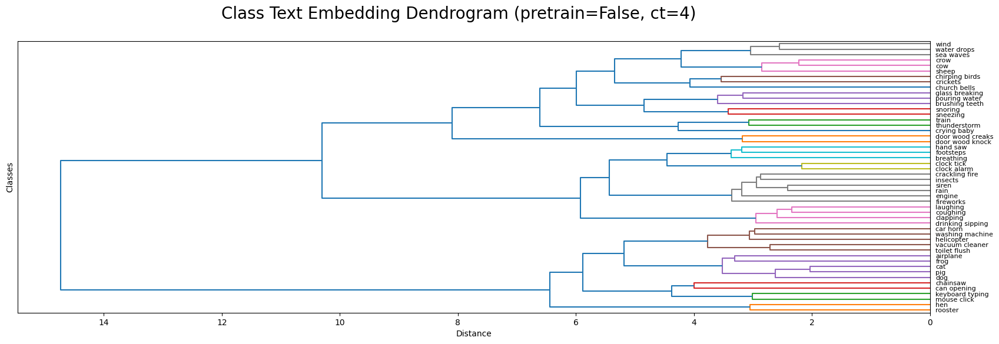

In [12]:
no_pt_class_order = plot_class_dendrogram(pretrain=False, ct=4)

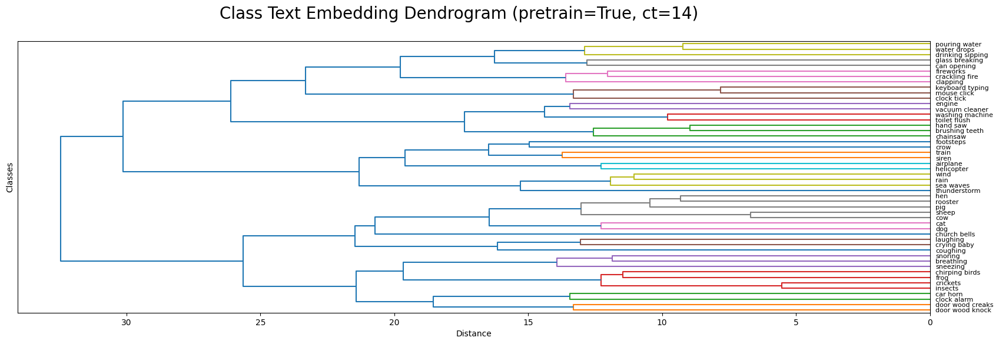

In [13]:
pt_class_order = plot_class_dendrogram(pretrain=True, ct=14)

#### t-SNE visualization

In [15]:
def tsne_plot(pretrain=True):
    tsne = TSNE(n_components=2, random_state=42)
    embeddings = pretrain_embedded_text if pretrain else no_pretrain_embedded_text
    embeddings = embeddings.detach().cpu().numpy()
    transformed_embeddings = tsne.fit_transform(embeddings)
    labels = dataset.classes

    # Use plotly to plot the embeddings
    fig = px.scatter(x=transformed_embeddings[:, 0], y=transformed_embeddings[:, 1], color=labels)
    fig.update_layout(
        title=f'Class Text Embedding T-SNE Plot (pretrain={pretrain})',
        xaxis_title='Dimension 1',
        yaxis_title='Dimension 2'
    )
    fig.show()

In [16]:
tsne_plot(pretrain=False)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x150180555940>
Traceback (most recent call last):
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
AttributeError: 'NoneType' object has no attribute 'split'


In [17]:
tsne_plot(pretrain=True)

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x150180555d30>
Traceback (most recent call last):
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
AttributeError: 'NoneType' object has no attribute 'split'


#### Similarity matrix heatmap

In [19]:
def heatmap(x, y, xlabel='', ylabel='', title='', order=None):
    # Function to calculate cosine similarity between two vectors
    def cosine_similarity(vec1, vec2):
        dot_product = np.dot(vec1, vec2)
        norm_vec1 = np.linalg.norm(vec1)
        norm_vec2 = np.linalg.norm(vec2)
        return dot_product / (norm_vec1 * norm_vec2)

    # Calculate pairwise similarities between vectors in both groups
    similarity_matrix = np.zeros((50, 50))  # Initialize a matrix to store the similarities

    # Reorder x, y and dataset.classes by order
    labels = dataset.classes
    if order:
        x = x[order]
        y = y[order]
        labels = [dataset.classes[x] for x in order]

    for i in range(50):
        for j in range(50):
            similarity_matrix[i, j] = cosine_similarity(y[i], x[j])

    fig = px.imshow(
        similarity_matrix, x=labels, y=labels, title=title,
        labels={'x': xlabel, 'y': ylabel, 'color': 'Cosine Similarity'},
    )

    fig.update_layout(width=1000, height=1000)

    fig.show()

In [20]:
pt = pretrain_embedded_text.detach().cpu().numpy()
no_pt = no_pretrain_embedded_text.detach().cpu().numpy()

In [25]:
heatmap(no_pt, no_pt, xlabel='No Pretrain', ylabel='No Pretrain', title='Text Embedding Cosine Self Similarity (No Pretrain)', order=pt_class_order)

In [27]:
heatmap(no_pt, no_pt, xlabel='No Pretrain', ylabel='No Pretrain', title='Text Embedding Cosine Self Similarity (No Pretrain)', order=no_pt_class_order)

In [24]:
heatmap(pt, pt, xlabel='Pretraining', ylabel='Pretraining', title='Text Embedding Cosine Self Similarity (Pretraining)', order=pt_class_order)

In [26]:
heatmap(pt, pt, xlabel='Pretrain', ylabel='Pretrain', title='Text Embedding Cosine Self Similarity (Pretraining)', order=no_pt_class_order)

In [1]:
heatmap(pt, pt, xlabel='Pretrain', ylabel='Pretrain', title='Text Embedding Cosine Self Similarity (Pretraining)')

NameError: name 'heatmap' is not defined

## Effect of pre-training on audio encoder

The language-audio pre-training in CLAP affects the audio encoder, which is unfrozen for 40 epochs during the training phase.

#### Audio encoder **without** language-audio pre-training

In [28]:
embeddings = pd.read_csv('/scratch/pratyaksh.g/esc50-cnn14-embeddings-44.1k.csv', index_col=0)
embeddings['embedding'] = embeddings['embedding'].apply(lambda x: x.split('[')[1].split(']')[0].split())
embeddings['embedding'] = embeddings['embedding'].apply(lambda x: [float(y) for y in x])

In [29]:
classwise_embeddings = []

# Take the average audio embedding for each class
for class_idx in range(NUM_CLASSES):
    class_embeddings = embeddings[embeddings['class_idx'] == class_idx]['embedding'].to_list()
    class_embeddings = np.array(class_embeddings)
    class_embeddings = class_embeddings.mean(axis=0)
    classwise_embeddings.append(class_embeddings)

no_pretrain_embedded_audios = np.array(classwise_embeddings)

#### Audio encoder **with** language-audio pre-training

In [30]:
clap_model.clap.audio_encoder.base.to(DEVICE)

Cnn14(
  (spectrogram_extractor): Spectrogram(
    (stft): STFT(
      (conv_real): Conv1d(1, 513, kernel_size=(1024,), stride=(320,), bias=False)
      (conv_imag): Conv1d(1, 513, kernel_size=(1024,), stride=(320,), bias=False)
    )
  )
  (logmel_extractor): LogmelFilterBank()
  (bn0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv_block1): ConvBlock(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_block2): ConvBlock(
    (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(

In [31]:
embeddings = pd.DataFrame(columns=['patch_idx', 'patch_name', 'class_name', 'class_idx', 'embedding'])

for patch_idx, patch in enumerate(tqdm(dataset)):
    audio_path, class_name, one_hot_target = patch
    class_idx = dataset.class_to_idx[class_name]
    patch_name = audio_path.split('/')[-1].split('.')[0]

    audio = clap_model.preprocess_audio([audio_path], False)
    audio = audio.reshape(audio.shape[0], audio.shape[2])
    audio_embedding = clap_model.clap.audio_encoder.base(audio.to(DEVICE))
    audio_embedding = audio_embedding['embedding'].squeeze().detach().cpu().numpy()

    embeddings.loc[len(embeddings)] = [patch_idx, patch_name, class_name, class_idx, audio_embedding]

  0%|          | 0/2000 [00:00<?, ?it/s]

In [32]:
classwise_embeddings = []

# Take the average audio embedding for each class
for class_idx in range(NUM_CLASSES):
    class_embeddings = embeddings[embeddings['class_idx'] == class_idx]['embedding'].to_list()
    class_embeddings = np.array(class_embeddings)
    class_embeddings = class_embeddings.mean(axis=0)
    classwise_embeddings.append(class_embeddings)

pretrain_embedded_audios = np.array(classwise_embeddings)

#### Comparing

#### Dendrograms

In [33]:
def plot_class_dendrogram(pretrain=True, ct=4):
    embeddings = pretrain_embedded_audios if pretrain else no_pretrain_embedded_audios

    fig = plt.figure(figsize=(20, 6))
    fig.suptitle(f'Class Audio Embedding Dendrogram (pretrain={pretrain}, ct={ct})', fontsize=20)
    plt.xlabel('Distance')
    plt.ylabel('Classes')

    R = dendrogram(
        linkage(embeddings, method='ward', metric='euclidean'),
        truncate_mode='none',
        color_threshold=ct,
        labels=dataset.classes,
        orientation='left'
    )

    filename = 'class-dendrogram-pretrain-audio' if pretrain else 'class-dendrogram-no-pretrain-audio'
    plt.savefig(f'/home2/pratyaksh.g/MS-CLAP/fig/{filename}.pdf')
    plt.show()

    return R['leaves']

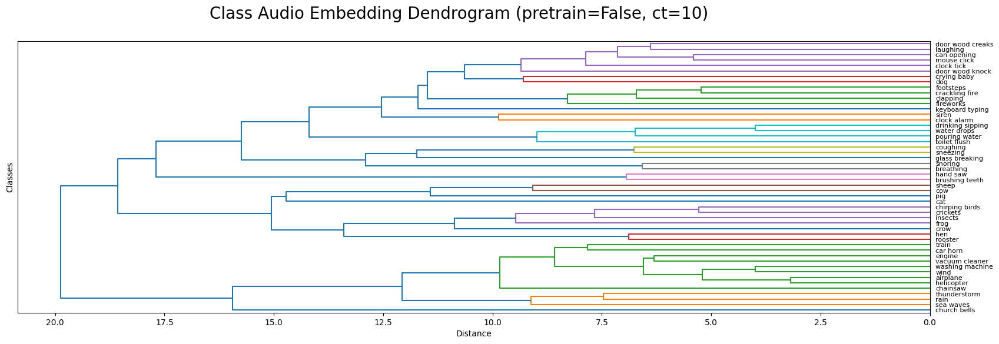

In [34]:
no_pt_class_order = plot_class_dendrogram(pretrain=False, ct=10)

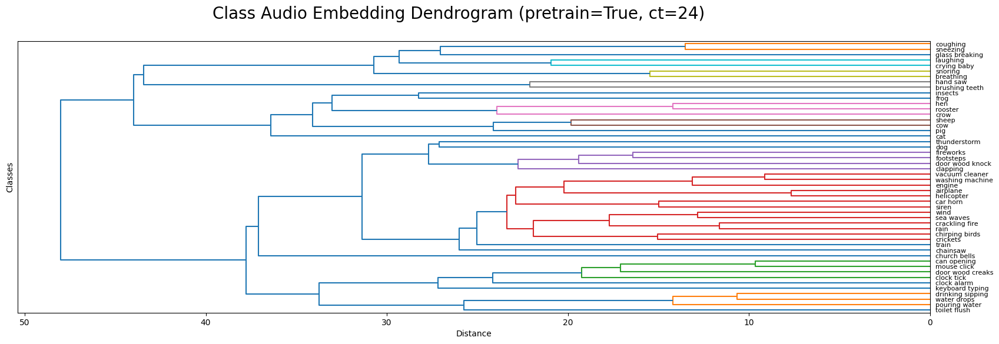

In [35]:
pt_class_order = plot_class_dendrogram(pretrain=True, ct=24)

#### t-SNE Visualization

In [30]:
def tsne_plot(pretrain=True):
    tsne = TSNE(n_components=2, random_state=42)
    embeddings = pretrain_embedded_audios if pretrain else no_pretrain_embedded_audios
    transformed_embeddings = tsne.fit_transform(embeddings)
    labels = dataset.classes

    # Use plotly to plot the embeddings
    fig = px.scatter(x=transformed_embeddings[:, 0], y=transformed_embeddings[:, 1], color=labels)
    fig.update_layout(
        title=f'Class Text Embedding T-SNE Plot (pretrain={pretrain})',
        xaxis_title='Dimension 1',
        yaxis_title='Dimension 2'
    )
    fig.show()

In [31]:
tsne_plot(pretrain=False)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x145d08c09e50>
Traceback (most recent call last):
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
AttributeError: 'NoneType' object has no attribute 'split'


In [32]:
tsne_plot(pretrain=True)

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x145d1c471160>
Traceback (most recent call last):
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
  File "/home2/pratyaksh.g/miniconda3/envs/ms-clap/lib/python3.8/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
AttributeError: 'NoneType' object has no attribute 'split'


#### Similarity matrix heatmap

In [36]:
pt = pretrain_embedded_audios
no_pt = no_pretrain_embedded_audios

In [42]:
heatmap(no_pt, no_pt, xlabel='No Pretrain', ylabel='No Pretrain', title='Audio Embedding Cosine Self Similarity (No Pretrain)', order=no_pt_class_order)

In [43]:
heatmap(pt, pt, xlabel='Pretraining', ylabel='Pretraining', title='Audio Embedding Cosine Self Similarity (Pretraining)', order=no_pt_class_order)

In [44]:
heatmap(no_pt, no_pt, xlabel='No Pretrain', ylabel='No Pretrain', title='Audio Embedding Cosine Self Similarity (No Pretrain)', order=pt_class_order)

In [41]:
heatmap(pt, pt, xlabel='Pretraining', ylabel='Pretraining', title='Audio Embedding Cosine Self Similarity (Pretraining)', order=pt_class_order)

# Scratch space

In [9]:
activations

,layer_idx,layer_name,neuron_idx,patch_idx,patch_name,raw_output,activation,class_idx,class_name
0,0,audio_encoder.base.fc1,0,0,1-100032-A-0,0.000000,0.000000,0,dog
1,0,audio_encoder.base.fc1,1,0,1-100032-A-0,1.418540,1.418540,0,dog
2,0,audio_encoder.base.fc1,2,0,1-100032-A-0,0.173165,0.173165,0,dog
3,0,audio_encoder.base.fc1,3,0,1-100032-A-0,0.028671,0.028671,0,dog
4,0,audio_encoder.base.fc1,4,0,1-100032-A-0,0.107833,0.107833,0,dog
...,...,...,...,...,...,...,...,...,...
8291995,3,classification_layer,45,1999,5-9032-A-0,0.000191,0.000191,0,dog
8291996,3,classification_layer,46,1999,5-9032-A-0,0.000011,0.000011,0,dog
8291997,3,classification_layer,47,1999,5-9032-A-0,0.000320,0.000320,0,dog
8291998,3,classification_layer,48,1999,5-9032-A-0,0.000001,0.000001,0,dog


In [11]:
ordered_neurons = dendrogram_ordering(0)
print(len(ordered_neurons))
print(ordered_neurons[:10])

2048
[1746, 1710, 1577, 1127, 880, 242, 866, 1385, 1392, 1034]


In [37]:
entropies

,layer_idx,neuron_idx,entropy,probabilities,cumulative_dist,dendrogram_index
0,0,0,2.282076,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.01, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0083330488632...",1506
1,0,1,2.611268,"[0.21, 0.02, 0.0, 0.0, 0.0, 0.01, 0.0, 0.0, 0....","[0.21565989106257236, 0.0179095698110575, 0.0,...",416
2,0,2,2.751653,"[0.0, 0.0, 0.0, 0.01, 0.0, 0.0, 0.0, 0.03, 0.0...","[0.0, 0.0, 0.0, 0.008016594251433567, 0.0, 0.0...",1377
3,0,3,3.105590,"[0.0, 0.0, 0.01, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0033250552020668346, 0.0, 0.0, 0....",472
4,0,4,3.533986,"[0.04, 0.01, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[0.03825714094405896, 0.00851370838937743, 0.0...",702
...,...,...,...,...,...,...
4141,3,45,2.872767,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.01, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.00390026...",21
4142,3,46,2.921923,"[0.01, 0.0, 0.0, 0.03, 0.0, 0.0, 0.0, 0.01, 0....","[4.870388355232819e-05, 0.0, 0.0, 0.0007410244...",2
4143,3,47,2.519778,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",19
4144,3,48,2.393838,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.01, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.00115680...",8


In [38]:
activations

,layer_idx,layer_name,neuron_idx,patch_idx,patch_name,raw_output,activation,class_idx,class_name
0,0,audio_encoder.base.fc1,0,0,1-100032-A-0,0.000000,0.000000,0,dog
1,0,audio_encoder.base.fc1,1,0,1-100032-A-0,1.418540,1.418540,0,dog
2,0,audio_encoder.base.fc1,2,0,1-100032-A-0,0.173165,0.173165,0,dog
3,0,audio_encoder.base.fc1,3,0,1-100032-A-0,0.028671,0.028671,0,dog
4,0,audio_encoder.base.fc1,4,0,1-100032-A-0,0.107833,0.107833,0,dog
...,...,...,...,...,...,...,...,...,...
8291995,3,classification_layer,45,1999,5-9032-A-0,0.000191,0.000191,0,dog
8291996,3,classification_layer,46,1999,5-9032-A-0,0.000011,0.000011,0,dog
8291997,3,classification_layer,47,1999,5-9032-A-0,0.000320,0.000320,0,dog
8291998,3,classification_layer,48,1999,5-9032-A-0,0.000001,0.000001,0,dog
